# GAN



In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import sys

path_to_homework = "/content/drive/My Drive/DeepLearning/GAN/"
sys.path.append(path_to_homework)

# Section 1. Generative Adversarial Networks on MNIST Dataset

In this section:
1. Implement two different types of loss functions (GAN / LSGAN) for generative adversarial networks. 
2. Build the Discriminator and Generator.
3. Implement training codes for your GAN models.
3. Train your model on MNIST dataset and visualize the generated images.


In [ ]:
import torch
import torch.nn as nn
from torchvision import datasets
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder

import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
def show_images(images, color=False):
    if color:
        sqrtimg = int(np.ceil(np.sqrt(images.shape[2]*images.shape[3])))
    else:
        images = np.reshape(images, [images.shape[0], -1])  # images reshape to (batch_size, D)
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))


    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        if color:
            plt.imshow(np.swapaxes(np.swapaxes(img, 0, 1), 1, 2))
        else:
            plt.imshow(img.reshape([sqrtimg,sqrtimg]))
    return 

def preprocess_img(x):
    return 2 * x - 1.0

def deprocess_img(x):
    return (x + 1.0) / 2.0

def rel_error(x,y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

def sample_noise(batch_size, dim):
    """
    Generate a PyTorch Tensor of uniform random noise.

    Input:
    - batch_size: Integer giving the batch size of noise to generate.
    - dim: Integer giving the dimension of noise to generate.
    
    Output:
    - A PyTorch Tensor of shape (batch_size, dim) containing uniform
      random noise in the range (-1, 1).
    """
    to_return = torch.randn((batch_size, dim))
    return to_return/torch.max(to_return)

In [ ]:
# set your device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(torch.cuda.get_device_name()) # GPU name

Tesla V100-SXM2-16GB


## Section 1.1. Vanilla GAN loss functions

### Section 1.1.1 GAN Loss 
Start from implementing the vanilla GAN loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). 

Recalled from the class, the generator loss is written as:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$



In [ ]:
import torch.nn.functional as F
from torch.autograd import Variable
def discriminator_loss(logits_real, logits_fake):
    """
    Computes the discriminator loss.
 
    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.
 
    Inputs:
    - logits_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Returns:
    - loss: PyTorch Tensor containing (scalar) the loss for the discriminator.
    """
 
    loss = None
    

    # logits_real.shape: torch.Size([128]) ,  logits_fake.shape: torch.Size([128])
    N = logits_real.shape[0]

    # real_data_label.shape: torch.Size([128]) ,  fake_data_label.shape: torch.Size([128])
    real_data_label = Variable(torch.ones(N).type(torch.float64)).to(device)
    fake_data_label = Variable(torch.zeros(N).type(torch.float64)).to(device)


    real_data_loss = F.binary_cross_entropy_with_logits(logits_real,real_data_label)
    fake_data_loss = F.binary_cross_entropy_with_logits(logits_fake,fake_data_label)
    
    loss = real_data_loss + fake_data_loss
    ##########       END      ##########
    return loss

def generator_loss(logits_fake):
    """
    Computes the generator loss.

    You should use the stable torch.nn.functional.binary_cross_entropy_with_logits
    loss rather than using a separate softmax function followed by the binary cross
    entropy loss.

    Inputs:
    - logits_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
    
    Returns:
    - loss: PyTorch Tensor containing the (scalar) loss for the generator.
    """

    loss = None
 
    N = logits_fake.shape[0]

    fake_data_label = Variable(torch.ones(N).type(torch.float64)).to(device)
    loss = F.binary_cross_entropy_with_logits(logits_fake,fake_data_label)

    ##########       END      ##########
    return loss

### Section 1.1.2 Build simple model 

Build simple model using below layers:

**Discriminator:**

- Flatten input (flatten the C x H x W into a single vector per image)
- linear (784, 256)
- Leaky ReLU ()
- Linear(256, 256)
- Leaky ReLU()
- Linear(256, 1)

**Generator:**
- Linear(noise_dim, 1024)
- ReLU()
- Linear(1024, 1024)
- ReLU()
- linear(1024, 784)
- Tanh()

In [ ]:
NOISE_DIM = 100

def discriminator():
    """
    Initialize and return a simple discriminator model.
    """
    model = nn.Sequential(
        nn.Flatten(start_dim=1, end_dim=-1),
        nn.Linear(784,256),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),
        nn.Linear(256,256),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),
        nn.Linear(256,1)
        
    )
    return model

def generator(noise_dim=NOISE_DIM):
    """
    Initialize and return a simple generator model.
    """

    model = nn.Sequential(
        nn.Linear(noise_dim, 1024),
        nn.Linear(1024,1024),
        nn.ReLU(),
        nn.Linear(1024, 784),
        nn.Tanh()
    )
    return model

### Section 1.1.3 Training code 
Implement the GAN training procedure following the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf) . 

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
 
def train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/Vanilla_gan_MINST/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=10, train_loader=None, device=None):
    """
    Train loop for GAN.

    The loop will consist of two steps: a discriminator step and a generator step.

    (1) In the discriminator step, you should zero gradients in the discriminator
    and sample noise to generate a fake data batch using the generator. Flatten real images 
    to 784 (28 * 28). Calculate the discriminator output for real and fake data, 
    and use the output to compute discriminator loss. Call backward() on the loss 
    output and take an optimizer step for the discriminator.

    (2) For the generator step, you should once again zero gradients in the generator
    and sample noise to generate a fake data batch. Get the discriminator output
    for the fake data batch and use this to compute the generator loss. Once again
    call backward() on the loss and take an optimizer step.

    You will need to reshape the fake image tensor outputted by the generator to
    be dimensions (batch_size x input_channels x img_size x img_size).

    Use the sample_noise function to sample random noise, and the discriminator_loss
    and generator_loss functions for their respective loss computations

    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    - train_loader: image dataloader
    - device: PyTorch device
    """
    if os.path.exists(os.path.join(ckpt_dir, 'checkpoint.pth')) and cont_train:
        ckpt = torch.load(os.path.join(ckpt_dir, 'checkpoint.pth'))
        start_epoch = ckpt['epoch'] + 1
        iter_count = ckpt['iter_count'] + 1
        G.load_state_dict(ckpt['G'])
        D.load_state_dict(ckpt['D'])
        print('Start from a checkpoint: {}, epoch:{}, iter:{}'.format(os.path.join(ckpt_dir, 'checkpoint.pth'), 
                                                 str(start_epoch), str(iter_count)))
    else:
        start_epoch = 0
        iter_count = 0
        
    for epoch in range(start_epoch, num_epochs):
        print('EPOCH: ', (epoch+1))
        for x, _ in train_loader:
            _, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(Variable(x).type(torch.float64)).to(device)  # normalize

            # Store discriminator loss output, generator loss output, and fake image output
            # in these variables for logging and visualization below
            d_error = None
            g_error = None
            fake_images = None


            ####################################
            #        Discriminator step        #
            #                                  #
            ####################################
            # 1. you should zero gradients in the discriminator
            D_solver.zero_grad()

            # 2. sample noise to generate a fake data batch using the generator
            noise_sample = Variable(sample_noise(batch_size=batch_size, dim=noise_size)).type(torch.float64).to(device)
            fake_images = G(noise_sample).detach().to(device)

            # 3.Flatten real images to batch_size*channel*784 (28 * 28)
            #real_image_flatten = real_image_flatten.reshape(batch_size, -1)

            # 4.Calculate the discriminator output for real and fake data
            real_images_output = D(real_images).type(torch.float64).squeeze()
            fake_images_output = D(fake_images.reshape(batch_size, input_channels, img_size, img_size)).squeeze()

            # 5. compute discriminator loss
            d_error = discriminator_loss(real_images_output, fake_images_output)
            d_error.backward()
            D_solver.step()

            #########       END      ###########
 
            ####################################
            #          Generator step          #
            #          YOUR CODE HERE          #
            ####################################

            # 1. zero gradients in the generator
            G_solver.zero_grad()

            # 2. sample noise to generate a fake data batch
            noise_sample = Variable(sample_noise(batch_size=batch_size, dim=noise_size)).type(torch.float64).to(device)
            g_fake_images = G(noise_sample).to(device)

            # 3. Get the discriminator output for the fake data batch
            g_fake_images_output = D(g_fake_images.reshape(batch_size, input_channels, img_size, img_size)).squeeze()
            
            # 4. compute the generator loss
            g_error = generator_loss(g_fake_images_output)
            g_error.backward()
            G_solver.step()
            ##########       END      ##########
            if (iter_count % show_every == 0):
                print('Iter: {}, D: {:.4}, G:{:.4}'.format(iter_count,d_error.item(),g_error.item()))
                disp_fake_images = deprocess_img(fake_images.data)  # denormalize
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels!=1)
                plt.show()
                print()
            iter_count += 1
            
        # save checkpoints
        os.makedirs(ckpt_dir, exist_ok=True)
        print('Saving the model as a checkpoint...')
        torch.save({'epoch': epoch, 
                    'iter_count': iter_count,
                    'G': G.state_dict(), 
                    'D': D.state_dict()}, 
                   os.path.join(ckpt_dir, 'checkpoint.pth'))

 Test the loss functions and training code on MNIST

Extracting ./MNIST_data/MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST_data/MNIST/raw


Extracting ./MNIST_data/MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST_data/MNIST/raw


Extracting ./MNIST_data/MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST_data/MNIST/raw


Extracting ./MNIST_data/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST_data/MNIST/raw
Processing...



Done!


/usr/local/lib/python3.6/dist-packages/torchvision/datasets/mnist.py:480: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


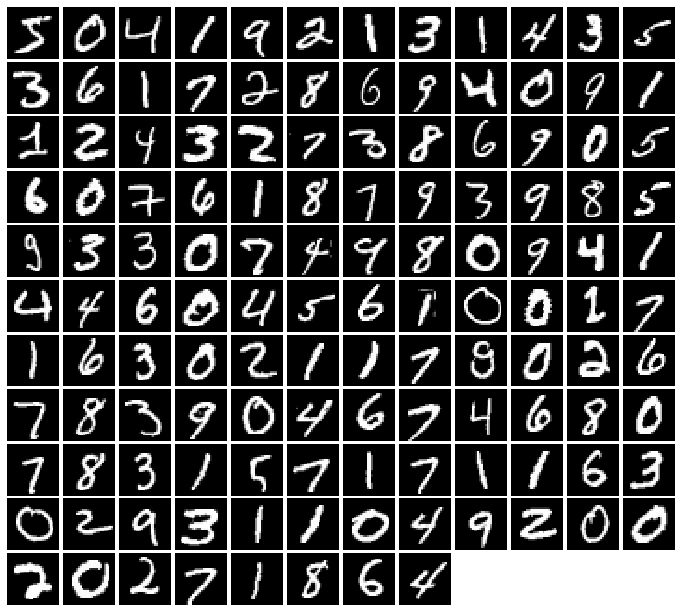

In [ ]:
batch_size = 128

mnist = datasets.MNIST('./MNIST_data', train=True, download=True,
                           transform=transforms.ToTensor())
loader_train = DataLoader(mnist, batch_size=batch_size, drop_last=True)


imgs = loader_train.__iter__().next()[0].view(batch_size, 784).numpy().squeeze()
show_images(imgs)

### Section 1.1.4 Train your model

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

EPOCH:  1
Iter: 0, D: 0.7115, G:0.7187


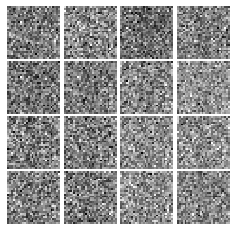


Iter: 250, D: 0.7151, G:0.7724


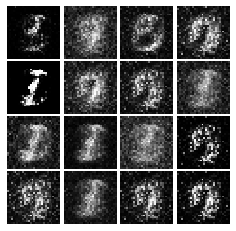


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 0.5849, G:0.9189


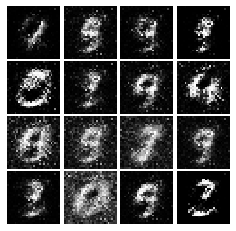


Iter: 750, D: 0.7313, G:0.6268


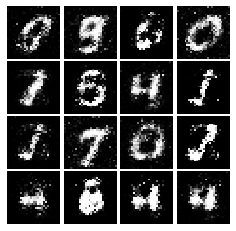


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 0.6384, G:0.9293


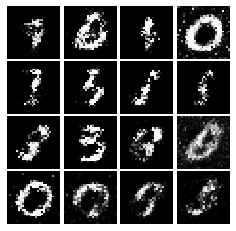


Iter: 1250, D: 0.6032, G:0.7622


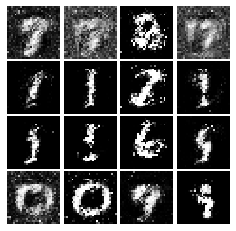


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 0.6765, G:0.9044


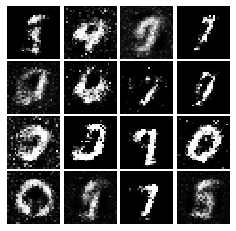


Iter: 1750, D: 0.6761, G:0.97


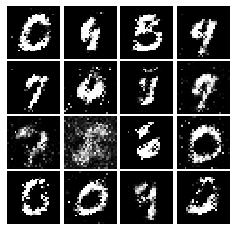


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 0.6323, G:0.8339


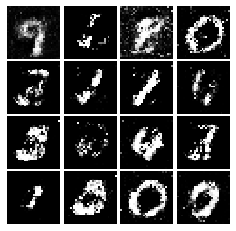


Iter: 2250, D: 0.6448, G:0.8369


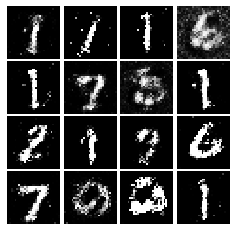


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 0.705, G:0.7963


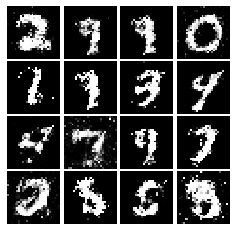


Iter: 2750, D: 0.6945, G:0.8303


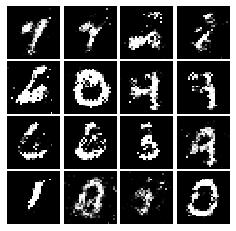


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 0.9331, G:0.8004


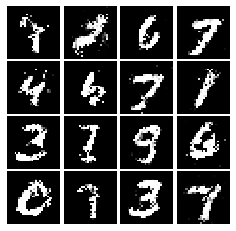


Iter: 3250, D: 0.6245, G:0.803


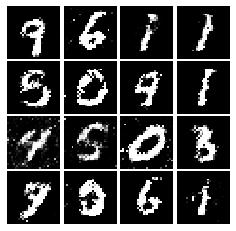


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 0.6946, G:0.8663


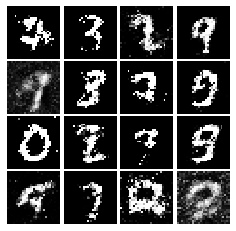


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 0.653, G:0.7814


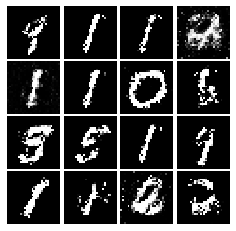


Iter: 4000, D: 0.6998, G:0.8321


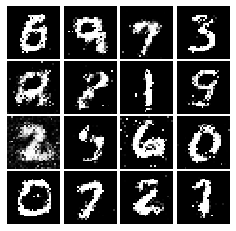


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 0.6531, G:0.8038


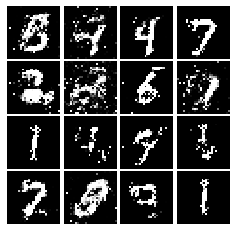


Iter: 4500, D: 0.6482, G:0.9131


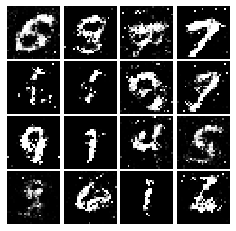


Saving the model as a checkpoint...


In [ ]:
# call Discriminator and Generator 
D = discriminator().type(torch.float64).to(device)
G = generator().type(torch.float64).to(device)

# call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
D_solver = torch.optim.Adam(D.parameters(), lr=1e-3, betas=(0.5, 0.999))
G_solver = torch.optim.Adam(G.parameters(), lr=1e-3, betas=(0.5, 0.999))

# call train function to train
train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, train_loader=loader_train, device=device)

## Section 1.2 Least-square GAN Loss
### Section 1.2.1 LSGAN Loss 
We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. 
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$
Fill in the `ls_discriminator_loss` and `ls_generator_loss` in the cell below.


In [ ]:
def ls_discriminator_loss(logits_real, logits_fake):
    """
    Compute the Least-Squares GAN loss for the discriminator.

    Inputs:
    - scores_real: PyTorch Tensor of shape (N,) giving scores for the real data.
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """
 
    loss = None
    mse_loss = nn.MSELoss(size_average=True, reduce = True)

    # logits_real.shape: torch.Size([128]) ,  logits_fake.shape: torch.Size([128])
    N = logits_real.shape[0]

    # real_data_label.shape: torch.Size([128]) ,  fake_data_label.shape: torch.Size([128])
    real_data_label = Variable(torch.ones(N).type(torch.float64)).to(device)
    fake_data_label = Variable(torch.zeros(N).type(torch.float64)).to(device)


    real_data_loss = mse_loss(logits_real,real_data_label)
    fake_data_loss = mse_loss(logits_fake,fake_data_label)

 
    loss = torch.div(real_data_loss + fake_data_loss, 2)
    ##########       END      ##########
    return loss

def ls_generator_loss(logits_fake):
    """
    Computes the Least-Squares GAN loss for the generator.
 
    Inputs:
    - scores_fake: PyTorch Tensor of shape (N,) giving scores for the fake data.
 
    Outputs:
    - loss: A PyTorch Tensor containing the loss.
    """

    loss = None
    mse_loss = nn.MSELoss(size_average=True, reduce = True) 
    ####################################
    #          YOUR CODE HERE          #
    ####################################
    N = logits_fake.shape[0]

    fake_data_label = Variable(torch.ones(N).type(torch.float64)).to(device)
    loss = 0.5*mse_loss(logits_fake,fake_data_label)
  
    ##########       END      ##########
    return loss    

### Section 1.2.2 Train model with LSGAN loss

- Call Discriminator and Generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
- Call train function to train. 
- Train for 10 epochs.

Similarly, train your LSGAN on MNIST dataset. 

EPOCH:  1
Iter: 0, D: 0.5205, G:0.9424


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


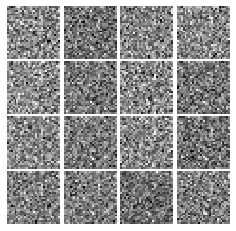


Iter: 250, D: 0.185, G:1.25


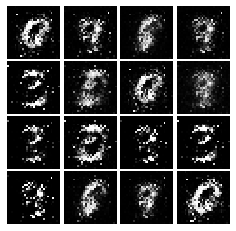


Saving the model as a checkpoint...
EPOCH:  2
Iter: 500, D: 0.1616, G:0.728


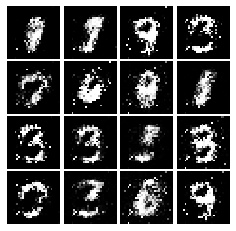


Iter: 750, D: 0.1844, G:0.5234


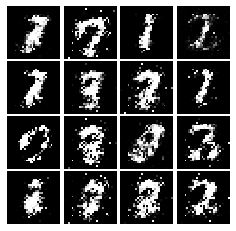


Saving the model as a checkpoint...
EPOCH:  3
Iter: 1000, D: 0.2029, G:0.2662


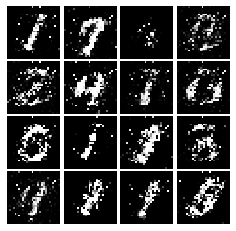


Iter: 1250, D: 0.2141, G:0.3462


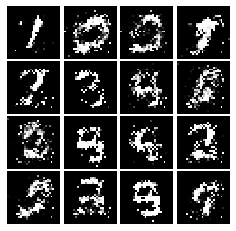


Saving the model as a checkpoint...
EPOCH:  4
Iter: 1500, D: 0.2237, G:0.3451


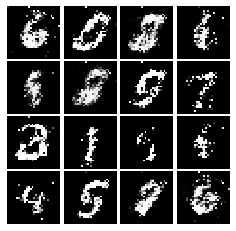


Iter: 1750, D: 0.2332, G:0.3612


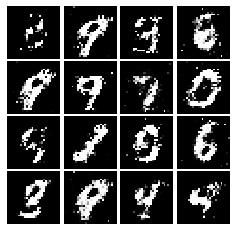


Saving the model as a checkpoint...
EPOCH:  5
Iter: 2000, D: 0.2187, G:0.3932


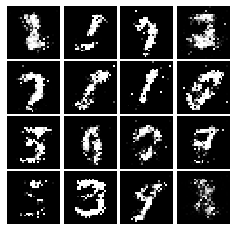


Iter: 2250, D: 0.2252, G:0.2908


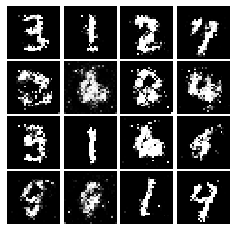


Saving the model as a checkpoint...
EPOCH:  6
Iter: 2500, D: 0.2411, G:0.3573


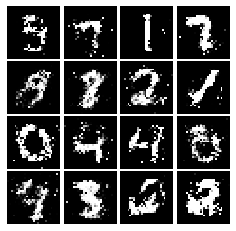


Iter: 2750, D: 0.2336, G:0.3129


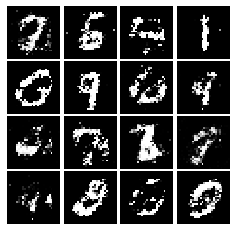


Saving the model as a checkpoint...
EPOCH:  7
Iter: 3000, D: 0.2338, G:0.335


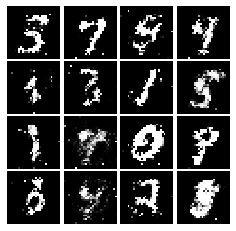


Iter: 3250, D: 0.2214, G:0.3124


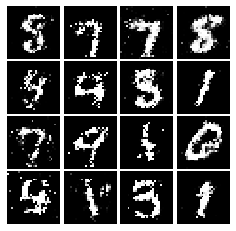


Saving the model as a checkpoint...
EPOCH:  8
Iter: 3500, D: 0.2356, G:0.3335


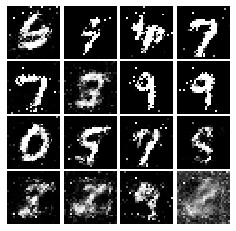


Saving the model as a checkpoint...
EPOCH:  9
Iter: 3750, D: 0.2468, G:0.3447


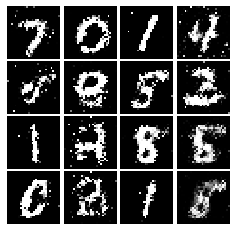


Iter: 4000, D: 0.2451, G:0.3093


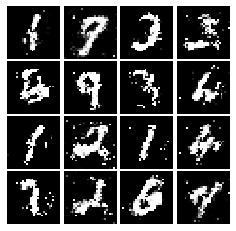


Saving the model as a checkpoint...
EPOCH:  10
Iter: 4250, D: 0.2086, G:0.3623


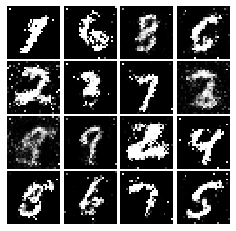


Iter: 4500, D: 0.2266, G:0.3386


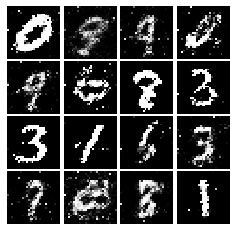


Saving the model as a checkpoint...


In [ ]:


# call Discriminator and Generator 
ls_D = discriminator().type(torch.float64).to(device)
ls_G = generator().type(torch.float64).to(device)

# call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
ls_D_solver = torch.optim.Adam(ls_D.parameters(), lr=1e-3, betas=(0.5, 0.999))
ls_G_solver = torch.optim.Adam(ls_G.parameters(), lr=1e-3, betas=(0.5, 0.999))

# call train function to train
train(ls_D, ls_G, ls_D_solver, ls_G_solver, ls_discriminator_loss, ls_generator_loss, train_loader=loader_train, device=device)

# Section 2. Generative Adversarial Networks on CelebA Dataset

In this section, you will need to:
1. Implement DCGAN architecture
2. Train it on CelebA dataset.

Implement a specific model architecture called [DCGAN](https://arxiv.org/pdf/1511.06434.pdf), and train the model to generate human faces!

### Section 2.1. GAN model architecture

Implement your generator and discriminator for generating faces. We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):
**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we use LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2






In [ ]:
# YOUR GENERATOR/DISCRIMINATOR HERE
NOISE_DIM = 100


def dc_discriminator():
    """
    Initialize and return a deep convolution discriminator model.
    """

    model = nn.Sequential(
        
        # input shape (3,64,64)
        nn.Conv2d(in_channels=3, out_channels=128, kernel_size=4, stride=2, padding=1),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),
        
        # feature map shape (128, 32, 32)
        nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),

        # feature map shape (256, 16, 16)
        nn.Conv2d(in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),


        # feature map shape (512, 8, 8)
        nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(1024),
        nn.LeakyReLU(negative_slope=1e-2, inplace=True),


        # feature map shape (1024, 4, 4)
        nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=4, stride=1, padding=0),

        # feature map shape (1, 1, 1)
        #nn.Sigmoid()
        
    )
    return model


def dc_generator(noise_dim=NOISE_DIM):
    """
    Initialize and return a simple generator model.
    """
    # Your code here:
    model = nn.Sequential(
        nn.ConvTranspose2d(in_channels=NOISE_DIM,  out_channels=1024, kernel_size=4, stride=1, padding=0),
        nn.BatchNorm2d(1024),
        nn.ReLU(),
        # feature map shape: 1024*4*4

        nn.ConvTranspose2d(in_channels=1024,  out_channels=512, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(512),
        nn.ReLU(),  
        # feature map shape: 512*8*8   

        nn.ConvTranspose2d(in_channels=512,  out_channels=256, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(256),
        nn.ReLU(),   
        # feature map shape (256, 16, 16)

        nn.ConvTranspose2d(in_channels=256,  out_channels=128, kernel_size=4, stride=2, padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(),   
        # feature map shape (128, 32, 32)

        nn.ConvTranspose2d(in_channels=128,  out_channels=3, kernel_size=4, stride=2, padding=1,),   
        # feature map shape (3,64,64)

        nn.Tanh()
    )
    return model

### Section 2.2 Data loading: Celeb A Dataset

The CelebA images have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.


In [ ]:
!wget https://uofi.box.com/shared/static/q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip
!mkdir celeba_data
!unzip q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip -d celeba_data
!rm q4pf89jtkvjndi4f8ip7wofuulhhphjj.zip

In [ ]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [ ]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

# You can change the num_workers to speed up loading
celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

#### Visualize dataset

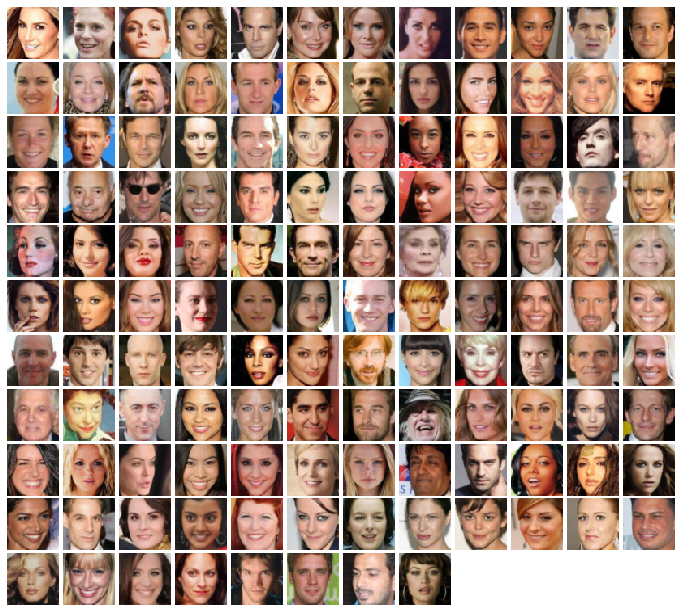

In [ ]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

### Section 2.3 Train a Vanilla GAN on CelebA 

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.


In [ ]:
NOISE_DIM = 100
NUM_EPOCHS = 30
learning_rate = 0.0002

In [ ]:
def dc_train(D, G, D_solver, G_solver, discriminator_loss, generator_loss, show_every=250, 
          ckpt_dir = path_to_homework + '/ckpts/DC_gan_CelebA/', cont_train=False,
          batch_size=128, noise_size=100, num_epochs=30, train_loader=None, device=None):
    """
    Train loop for GAN.

    The loop will consist of two steps: a discriminator step and a generator step.

    (1) In the discriminator step, you should zero gradients in the discriminator
    and sample noise to generate a fake data batch using the generator. Flatten real images 
    to 784 (28 * 28). Calculate the discriminator output for real and fake data, 
    and use the output to compute discriminator loss. Call backward() on the loss 
    output and take an optimizer step for the discriminator.

    (2) For the generator step, you should once again zero gradients in the generator
    and sample noise to generate a fake data batch. Get the discriminator output
    for the fake data batch and use this to compute the generator loss. Once again
    call backward() on the loss and take an optimizer step.

    You will need to reshape the fake image tensor outputted by the generator to
    be dimensions (batch_size x input_channels x img_size x img_size).

    Use the sample_noise function to sample random noise, and the discriminator_loss
    and generator_loss functions for their respective loss computations

    Inputs:
    - D, G: PyTorch models for the discriminator and generator
    - D_solver, G_solver: torch.optim Optimizers to use for training the
      discriminator and generator.
    - discriminator_loss, generator_loss: Functions to use for computing the generator and
      discriminator loss, respectively.
    - show_every: Show samples after every show_every iterations.
    - batch_size: Batch size to use for training.
    - noise_size: Dimension of the noise to use as input to the generator.
    - num_epochs: Number of epochs over the training dataset to use for training.
    - train_loader: image dataloader
    - device: PyTorch device
    """

    print("num_epochs: ", num_epochs)
    if os.path.exists(os.path.join(ckpt_dir, 'checkpoint.pth')) and cont_train:
        ckpt = torch.load(os.path.join(ckpt_dir, 'checkpoint.pth'))
        start_epoch = ckpt['epoch'] + 1
        iter_count = ckpt['iter_count'] + 1
        G.load_state_dict(ckpt['G'])
        D.load_state_dict(ckpt['D'])
        print('Start from a checkpoint: {}, epoch:{}, iter:{}'.format(os.path.join(ckpt_dir, 'checkpoint.pth'), 
                                                 str(start_epoch), str(iter_count)))
    else:
        start_epoch = 0
        iter_count = 0
        
    for epoch in range(start_epoch, num_epochs):
        print('EPOCH: ', (epoch+1))
        for x, _ in train_loader:
            _, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(Variable(x).type(torch.float64)).to(device)  # normalize

            # Store discriminator loss output, generator loss output, and fake image output
            # in these variables for logging and visualization below
            d_error = None
            g_error = None
            fake_images = None


            ####################################
            #        Discriminator step        #
            ####################################
            # 1. you should zero gradients in the discriminator
            D_solver.zero_grad()

            # 2. sample noise to generate a fake data batch using the generator
            noise_sample = Variable(sample_noise(batch_size=batch_size, dim=noise_size)).type(torch.float64).unsqueeze(-1).unsqueeze(-1).to(device)
            #print("before first generator")
            #print("noise_sample.shape: ", noise_sample.shape)
            fake_images = G(noise_sample).detach().to(device)
            #print("After first generator")  

            # 3.Flatten real images to batch_size*channel*784 (28 * 28)
            #real_image_flatten = real_image_flatten.reshape(batch_size, -1)

            # 4.Calculate the discriminator output for real and fake data
            #print("before first discriminator")
            real_images_output = D(real_images).type(torch.float64).squeeze()
            fake_images_output = D(fake_images.reshape(batch_size, input_channels, img_size, img_size)).squeeze()
            #print("After first discriminator")

            # 5. compute discriminator loss
            d_error = discriminator_loss(real_images_output, fake_images_output)
            d_error.backward()
            D_solver.step()

            #########       END      ###########
 
            ####################################
            #          Generator step          #
            #          YOUR CODE HERE          #
            ####################################

            # 1. zero gradients in the generator
            G_solver.zero_grad()

            # 2. sample noise to generate a fake data batch
            noise_sample = Variable(sample_noise(batch_size=batch_size, dim=noise_size)).type(torch.float64).unsqueeze(-1).unsqueeze(-1).to(device)
            g_fake_images = G(noise_sample).to(device)

            # 3. Get the discriminator output for the fake data batch
            g_fake_images_output = D(g_fake_images.reshape(batch_size, input_channels, img_size, img_size)).squeeze()
            
            # 4. compute the generator loss
            g_error = generator_loss(g_fake_images_output)
            g_error.backward()
            G_solver.step()
            ##########       END      ##########
            if (iter_count % show_every == 0):
                print('Iter: {}, D loss: {:.4}, G loss:{:.4}'.format(iter_count,d_error.item(),g_error.item()))
                disp_fake_images = deprocess_img(fake_images.data)  # denormalize
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels!=1)
                plt.show()
                print()
            iter_count += 1
            
        # save checkpoints
        os.makedirs(ckpt_dir, exist_ok=True)
        print('Saving the model as a checkpoint...')
        torch.save({'epoch': epoch, 
                    'iter_count': iter_count,
                    'G': G.state_dict(), 
                    'D': D.state_dict()}, 
                   os.path.join(ckpt_dir, 'checkpoint.pth'))

EPOCH:  1
Iter: 0, D loss: 0.9377, G loss:12.47


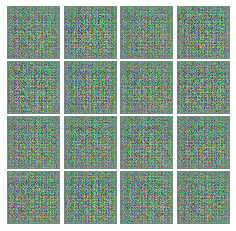


Iter: 250, D loss: 0.2858, G loss:9.551


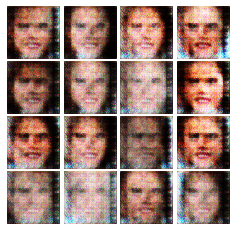


Iter: 500, D loss: 0.513, G loss:5.432


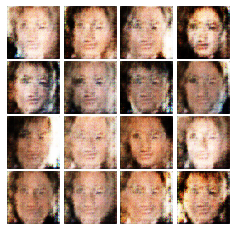


Iter: 750, D loss: 0.6634, G loss:10.34


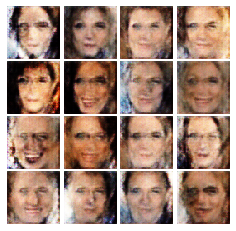


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D loss: 0.3156, G loss:3.657


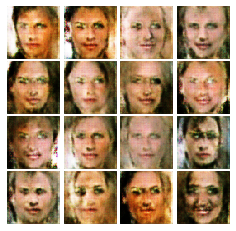


Iter: 1250, D loss: 0.212, G loss:4.305


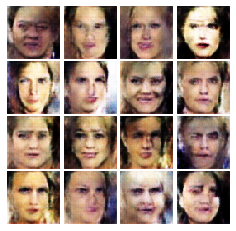


Iter: 1500, D loss: 0.215, G loss:4.489


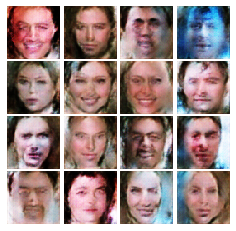


Iter: 1750, D loss: 0.218, G loss:2.421


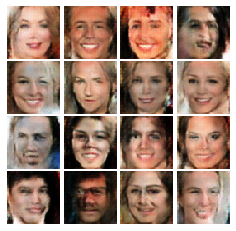


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D loss: 0.1282, G loss:4.195


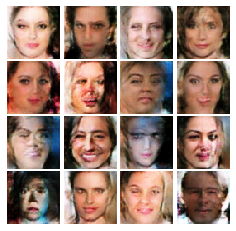


Iter: 2250, D loss: 0.2955, G loss:1.995


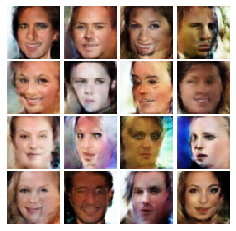


Iter: 2500, D loss: 0.366, G loss:1.881


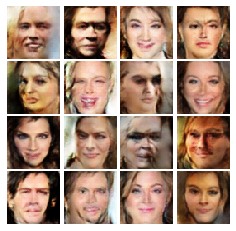


Iter: 2750, D loss: 0.3771, G loss:4.446


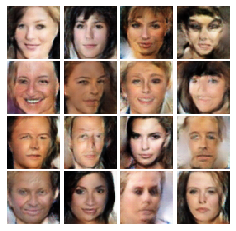


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D loss: 0.333, G loss:3.104


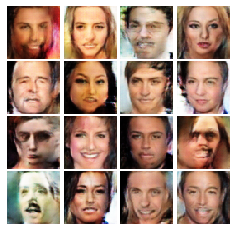


Iter: 3250, D loss: 0.3225, G loss:1.506


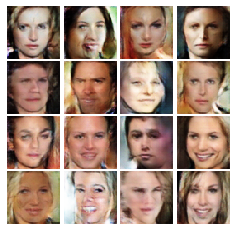


Iter: 3500, D loss: 0.6065, G loss:1.33


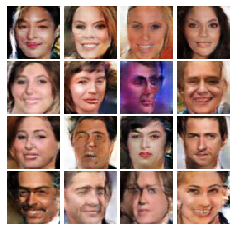


Iter: 3750, D loss: 0.2835, G loss:2.388


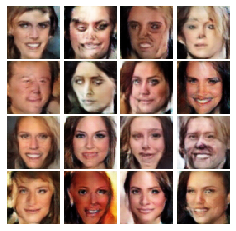


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D loss: 0.2115, G loss:2.891


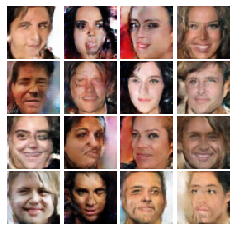


Iter: 4250, D loss: 0.4369, G loss:1.214


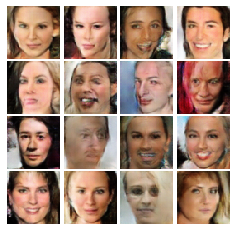


Iter: 4500, D loss: 0.1928, G loss:2.44


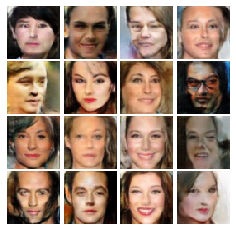


Iter: 4750, D loss: 0.594, G loss:5.895


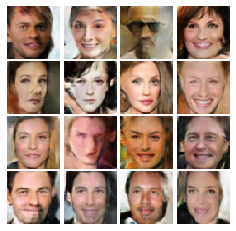


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D loss: 0.3122, G loss:6.071


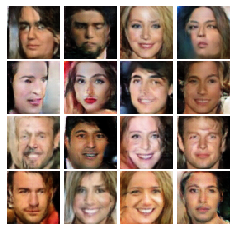


Iter: 5250, D loss: 0.1021, G loss:3.333


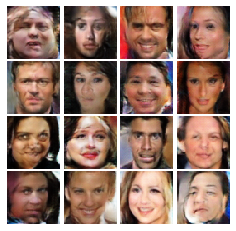


Iter: 5500, D loss: 0.1219, G loss:3.164


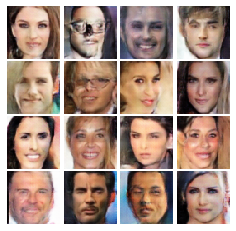


Iter: 5750, D loss: 1.176, G loss:7.851


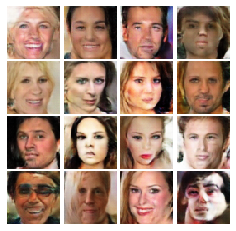


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D loss: 0.1829, G loss:4.122


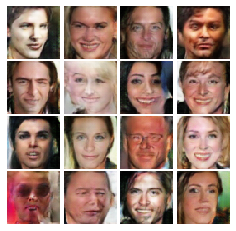


Iter: 6250, D loss: 2.324, G loss:0.5211


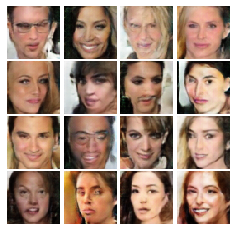


Iter: 6500, D loss: 0.1367, G loss:2.721


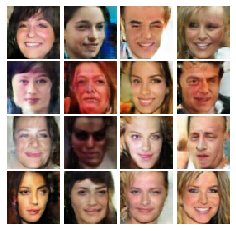


Iter: 6750, D loss: 0.1533, G loss:2.178


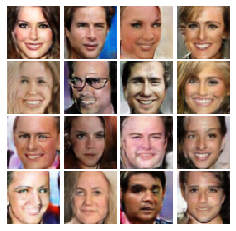


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D loss: 0.3641, G loss:4.408


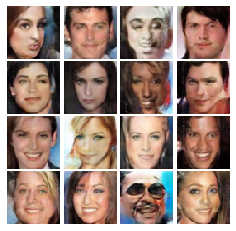


Iter: 7250, D loss: 0.2056, G loss:4.22


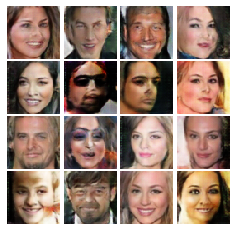


Iter: 7500, D loss: 0.1196, G loss:3.731


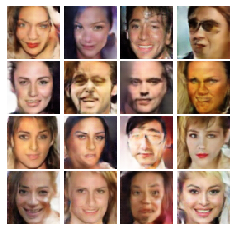


Iter: 7750, D loss: 0.1395, G loss:5.395


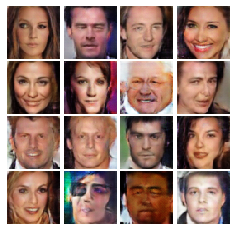


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D loss: 0.08409, G loss:3.97


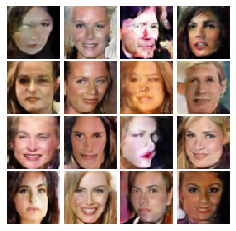


Iter: 8250, D loss: 0.1466, G loss:2.618


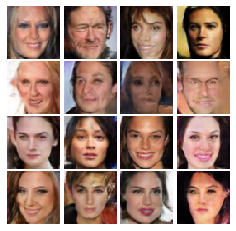


Iter: 8500, D loss: 0.1356, G loss:3.476


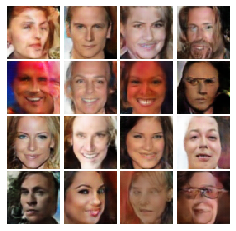


Iter: 8750, D loss: 0.2163, G loss:6.119


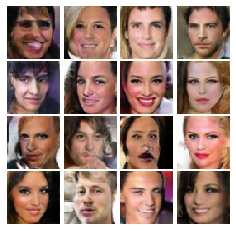


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D loss: 0.06623, G loss:3.971


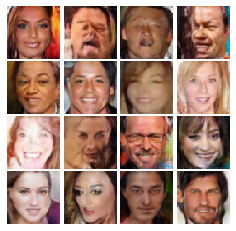


Iter: 9250, D loss: 0.1144, G loss:3.916


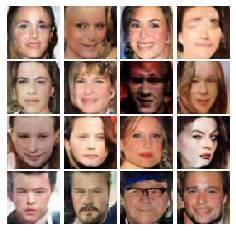


Iter: 9500, D loss: 0.1499, G loss:2.138


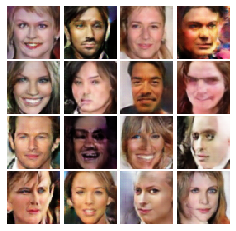


Iter: 9750, D loss: 0.1237, G loss:4.762


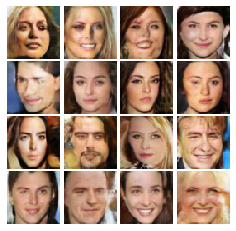


Saving the model as a checkpoint...


In [ ]:
# original GAN

# call Discriminator and Generator 
dc_D = dc_discriminator().type(torch.float64).to(device)
dc_G = dc_generator().type(torch.float64).to(device)

# call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
dc_D_solver = torch.optim.Adam(dc_D.parameters(), lr=learning_rate, betas=(0.5, 0.999))
dc_G_solver = torch.optim.Adam(dc_G.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# call train function to train
dc_train(dc_D, dc_G, dc_D_solver, dc_G_solver, discriminator_loss, generator_loss, train_loader=celeba_loader_train, device=device)

learning_rate: 0.0002
num_epochs:  30
Start from a checkpoint: /content/drive/My Drive/DeepLearning/Assignment_5//ckpts/DC_gan_CelebA/checkpoint.pth, epoch:10, iter:9861
EPOCH:  11
Iter: 10000, D loss: 0.4513, G loss:7.053


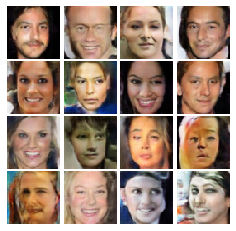


Iter: 10250, D loss: 0.09964, G loss:4.055


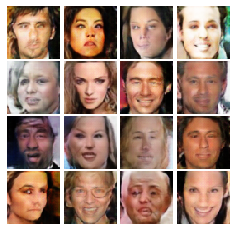


Iter: 10500, D loss: 0.1159, G loss:2.989


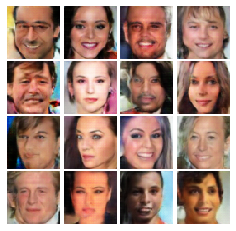


Iter: 10750, D loss: 0.0923, G loss:4.83


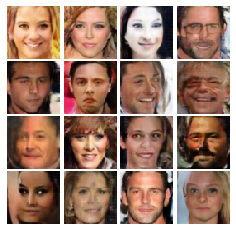


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D loss: 0.4983, G loss:0.6923


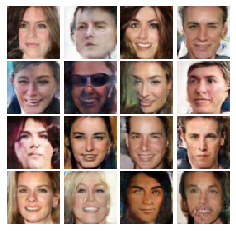


Iter: 11250, D loss: 0.09314, G loss:2.834


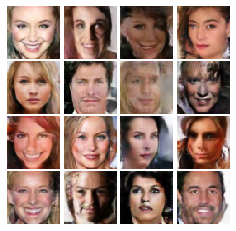


Iter: 11500, D loss: 0.0415, G loss:4.748


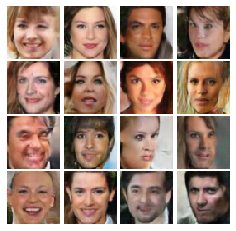


Iter: 11750, D loss: 0.1079, G loss:6.519


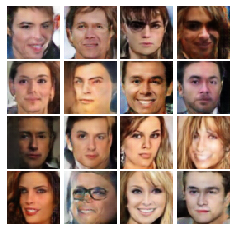


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D loss: 0.1838, G loss:2.472


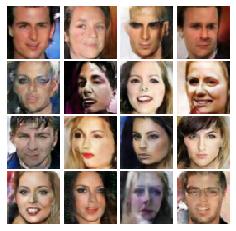


Iter: 12250, D loss: 0.02926, G loss:4.874


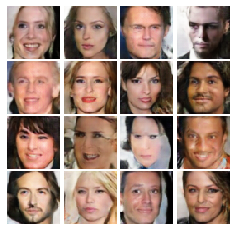


Iter: 12500, D loss: 0.1353, G loss:8.404


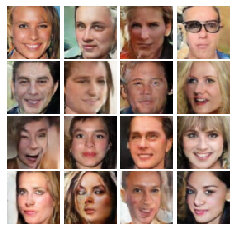


Iter: 12750, D loss: 0.08348, G loss:4.517


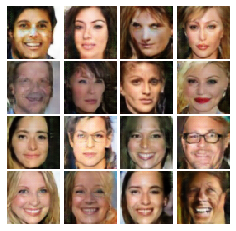


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D loss: 0.05155, G loss:4.815


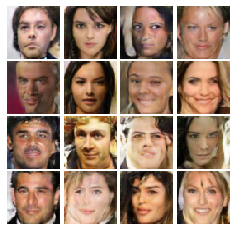


Iter: 13250, D loss: 0.02931, G loss:5.073


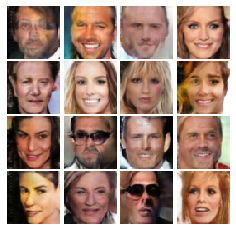


Iter: 13500, D loss: 0.1914, G loss:2.302


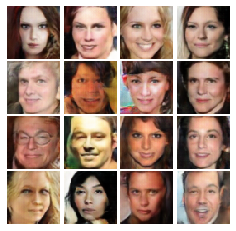


Iter: 13750, D loss: 0.127, G loss:3.788


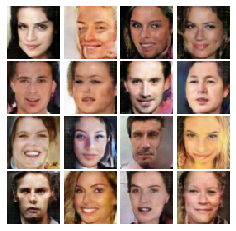


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D loss: 0.09569, G loss:2.855


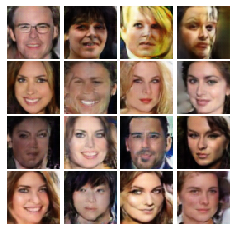


Iter: 14250, D loss: 0.0483, G loss:5.717


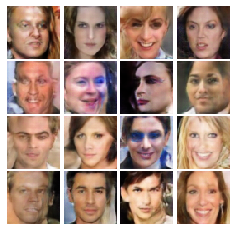


Iter: 14500, D loss: 0.06982, G loss:5.581


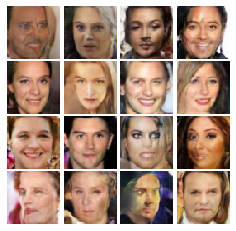


Iter: 14750, D loss: 0.1187, G loss:4.458


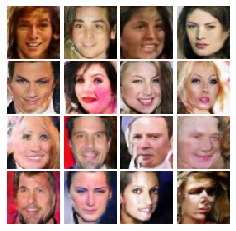


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D loss: 0.07846, G loss:4.833


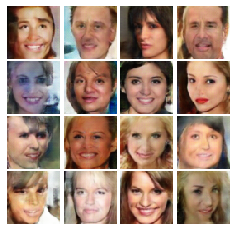


Iter: 15250, D loss: 0.0465, G loss:4.594


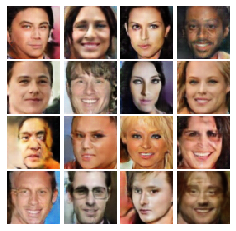


Iter: 15500, D loss: 0.6894, G loss:7.802


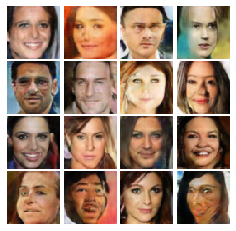


Iter: 15750, D loss: 0.03367, G loss:4.27


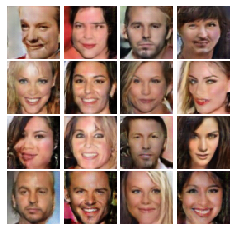


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D loss: 0.03242, G loss:5.598


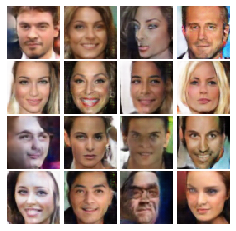


Iter: 16250, D loss: 0.0837, G loss:4.98


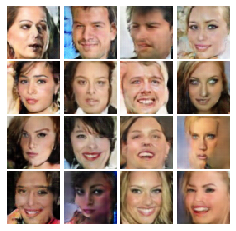


Iter: 16500, D loss: 0.0428, G loss:4.736


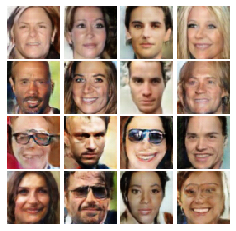


Iter: 16750, D loss: 0.06987, G loss:3.023


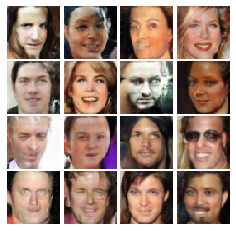


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D loss: 0.02842, G loss:4.868


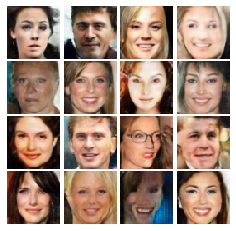


Iter: 17250, D loss: 0.09761, G loss:4.525


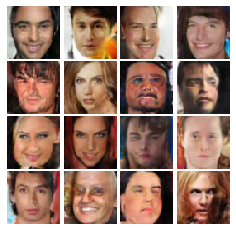


Iter: 17500, D loss: 0.08874, G loss:8.356


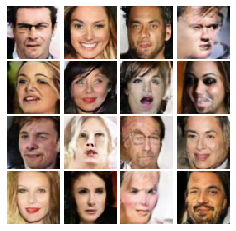


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D loss: 0.06584, G loss:3.768


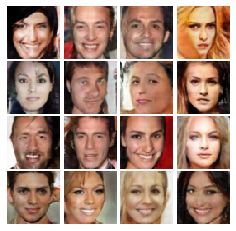


Iter: 18000, D loss: 0.04121, G loss:5.969


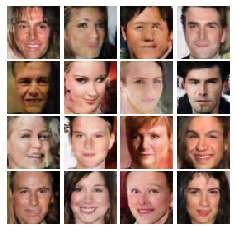


Iter: 18250, D loss: 0.1565, G loss:2.276


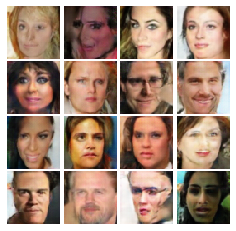


Iter: 18500, D loss: 0.06633, G loss:5.094


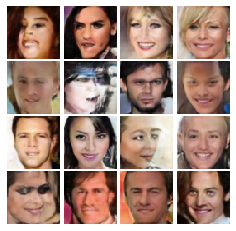


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D loss: 0.0412, G loss:6.768


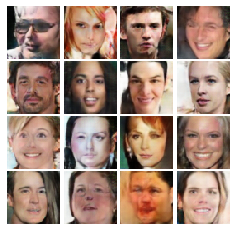


Iter: 19000, D loss: 0.2302, G loss:2.747


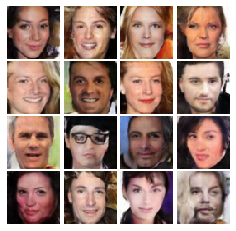


Iter: 19250, D loss: 0.1105, G loss:7.247


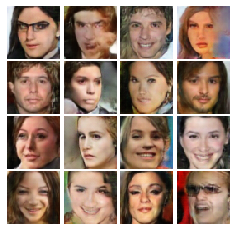


Iter: 19500, D loss: 0.01571, G loss:5.993


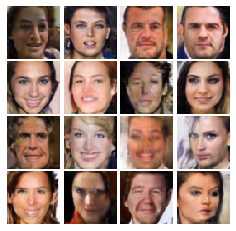


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D loss: 0.03696, G loss:5.151


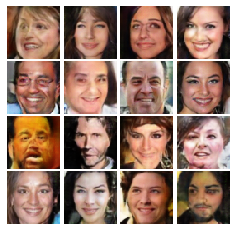


Iter: 20000, D loss: 0.05202, G loss:6.451


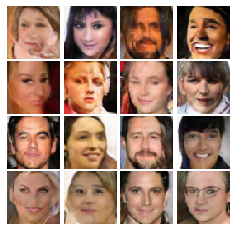


Iter: 20250, D loss: 0.03862, G loss:3.827


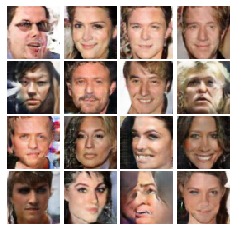


Iter: 20500, D loss: 0.0949, G loss:3.781


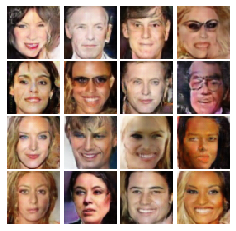


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D loss: 0.02411, G loss:5.672


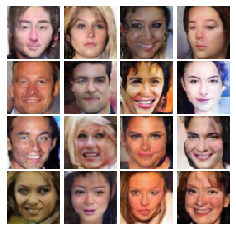


Iter: 21000, D loss: 0.02663, G loss:4.261


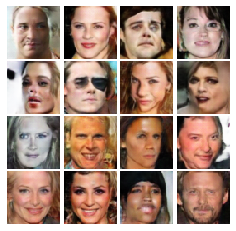


Iter: 21250, D loss: 0.08783, G loss:4.319


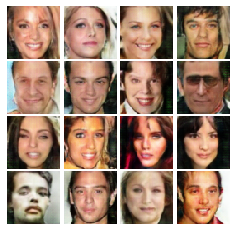


Iter: 21500, D loss: 0.03738, G loss:4.001


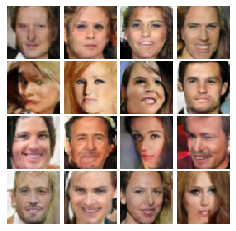


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D loss: 0.08023, G loss:5.664


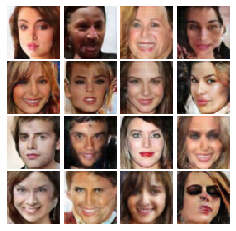


Iter: 22000, D loss: 0.05173, G loss:4.12


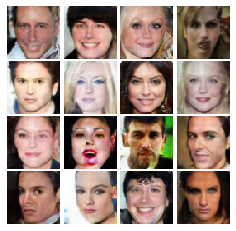


Iter: 22250, D loss: 0.093, G loss:1.985


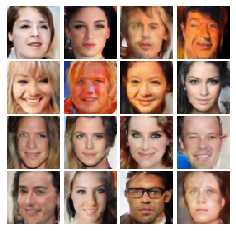


Iter: 22500, D loss: 0.02008, G loss:6.417


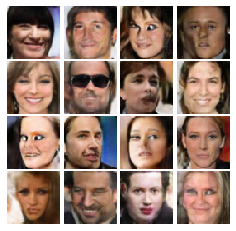


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D loss: 0.04721, G loss:7.006


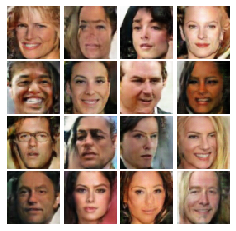


Iter: 23000, D loss: 0.07366, G loss:5.481


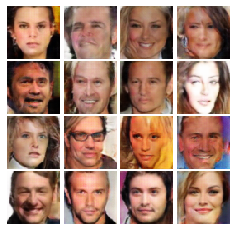


Iter: 23250, D loss: 0.428, G loss:2.077


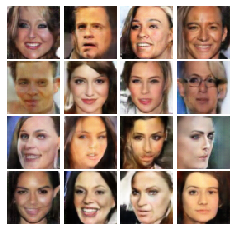


Iter: 23500, D loss: 0.6541, G loss:8.795


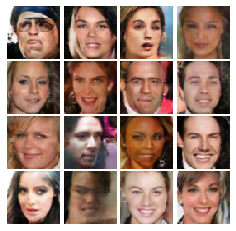


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D loss: 0.04035, G loss:7.431


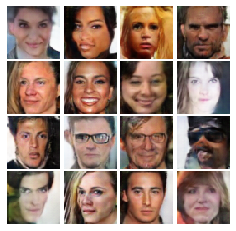


Iter: 24000, D loss: 0.03893, G loss:5.528


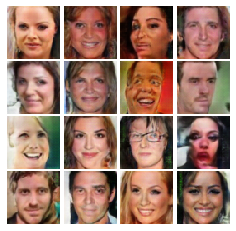


Iter: 24250, D loss: 0.1569, G loss:8.997


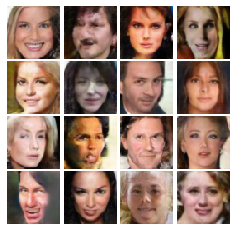


Iter: 24500, D loss: 2.144, G loss:11.05


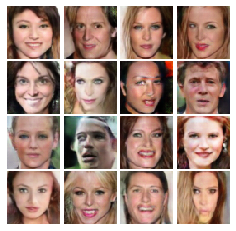


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D loss: 0.05066, G loss:5.685


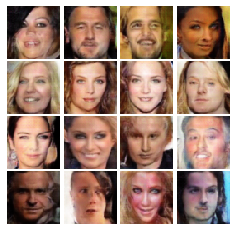


Iter: 25000, D loss: 0.03477, G loss:4.056


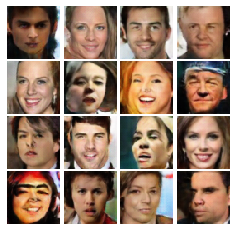


Iter: 25250, D loss: 0.01651, G loss:5.446


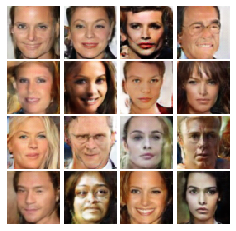


Iter: 25500, D loss: 0.02679, G loss:5.079


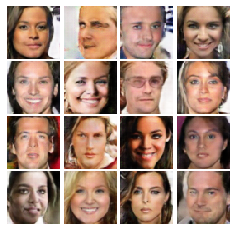


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D loss: 0.01104, G loss:6.62


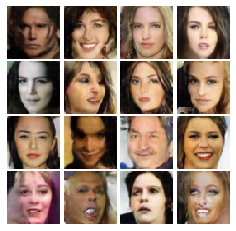


Iter: 26000, D loss: 0.06208, G loss:5.715


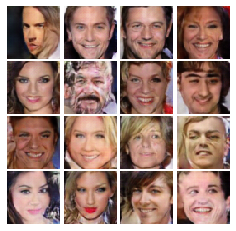


Iter: 26250, D loss: 0.03992, G loss:4.922


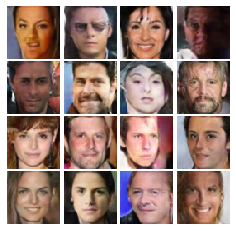


Iter: 26500, D loss: 0.0489, G loss:6.279


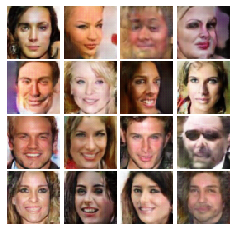


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D loss: 0.05871, G loss:4.359


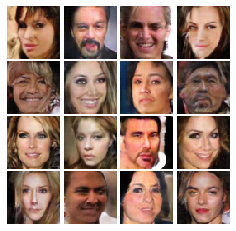


Iter: 27000, D loss: 0.02268, G loss:6.314


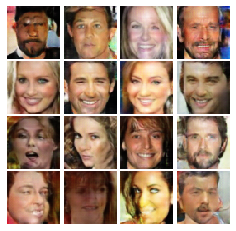


Iter: 27250, D loss: 0.1053, G loss:5.329


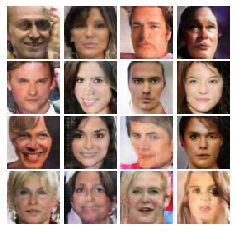


Iter: 27500, D loss: 0.02788, G loss:4.486


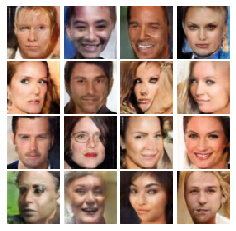


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D loss: 0.06372, G loss:6.37


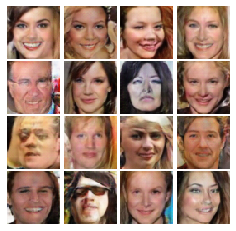


Iter: 28000, D loss: 0.05613, G loss:3.868


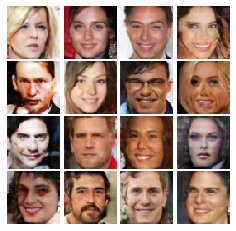


Iter: 28250, D loss: 0.03644, G loss:4.493


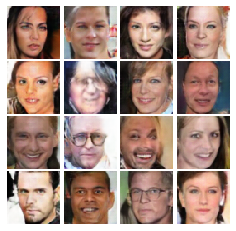


Iter: 28500, D loss: 0.02322, G loss:5.278


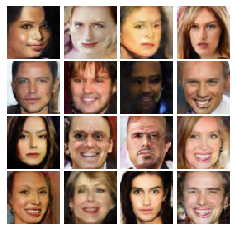


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D loss: 0.03629, G loss:8.042


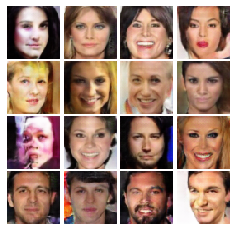


Iter: 29000, D loss: 0.1131, G loss:5.197


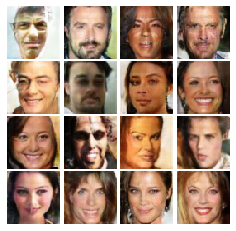


Iter: 29250, D loss: 0.06271, G loss:4.853


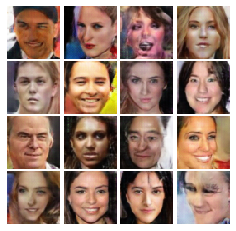


Iter: 29500, D loss: 0.1052, G loss:3.91


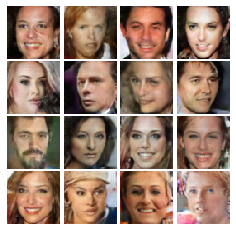


Saving the model as a checkpoint...


In [ ]:
# original GAN

# call Discriminator and Generator 
dc_D = dc_discriminator().type(torch.float64).to(device)
dc_G = dc_generator().type(torch.float64).to(device)

print("learning_rate:", learning_rate)

# call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
dc_D_solver = torch.optim.Adam(dc_D.parameters(), lr=learning_rate, betas=(0.5, 0.999))
dc_G_solver = torch.optim.Adam(dc_G.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# call train function to train
dc_train(dc_D, dc_G, dc_D_solver, dc_G_solver, discriminator_loss, generator_loss, train_loader=celeba_loader_train, device=device, cont_train=True)

### Section 2.4 Train a LSGAN on CelebA 

- Call discriminator and generator for training.
- Call optimizers for both discriminator and generator for training. (Use Adam with betas = (0.5, 0.999))
- Call train function to train. 
- Train for 30 epochs.

learning_rate: 0.0002
num_epochs: 30
EPOCH:  1


/usr/local/lib/python3.6/dist-packages/torch/nn/_reduction.py:44: UserWarning: size_average and reduce args will be deprecated, please use reduction='mean' instead.
  warnings.warn(warning.format(ret))


Iter: 0, D loss: 4.633, G loss:157.6


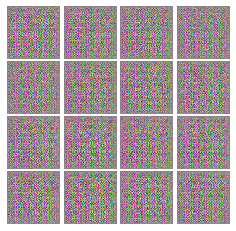


Iter: 250, D loss: 0.4789, G loss:3.018


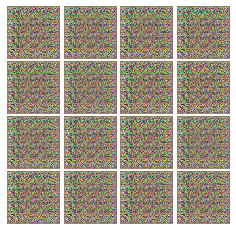


Iter: 500, D loss: 3.154, G loss:9.72


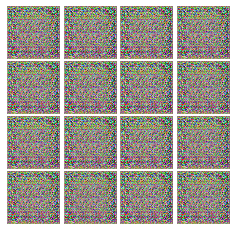


Iter: 750, D loss: 1.001, G loss:0.0715


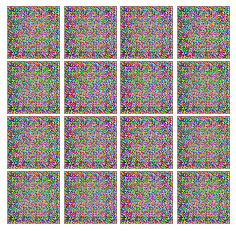


Saving the model as a checkpoint...
EPOCH:  2
Iter: 1000, D loss: 0.03942, G loss:1.379


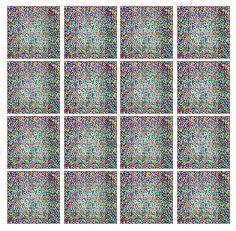


Iter: 1250, D loss: 0.01808, G loss:1.084


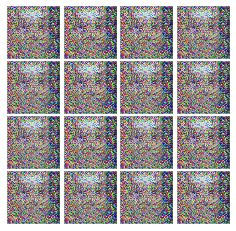


Iter: 1500, D loss: 0.519, G loss:0.009255


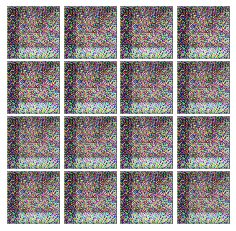


Iter: 1750, D loss: 1.418, G loss:1.562


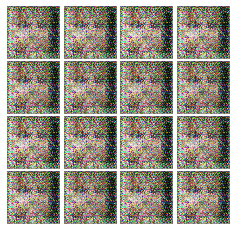


Saving the model as a checkpoint...
EPOCH:  3
Iter: 2000, D loss: 0.07647, G loss:1.17


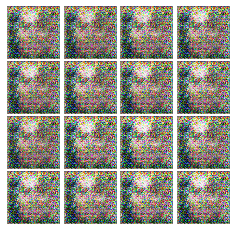


Iter: 2250, D loss: 0.06607, G loss:0.7513


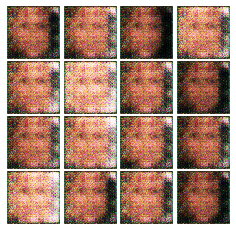


Iter: 2500, D loss: 0.05151, G loss:0.8897


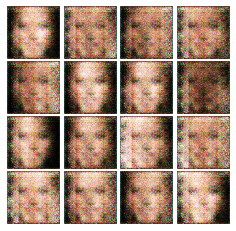


Iter: 2750, D loss: 0.09345, G loss:1.67


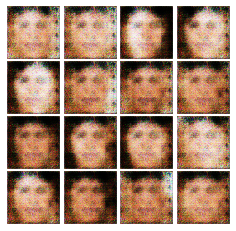


Saving the model as a checkpoint...
EPOCH:  4
Iter: 3000, D loss: 0.1696, G loss:0.7451


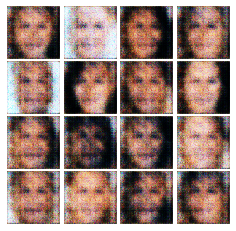


Iter: 3250, D loss: 0.1413, G loss:0.4581


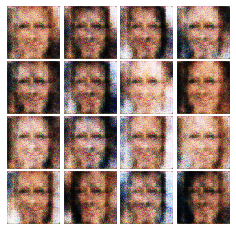


Iter: 3500, D loss: 0.09946, G loss:0.7568


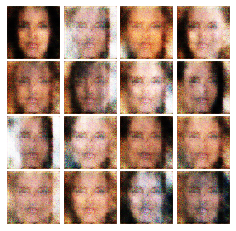


Iter: 3750, D loss: 0.1329, G loss:1.245


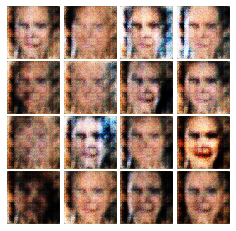


Saving the model as a checkpoint...
EPOCH:  5
Iter: 4000, D loss: 0.1943, G loss:0.3286


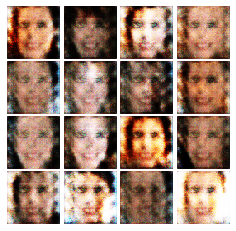


Iter: 4250, D loss: 0.7677, G loss:0.06047


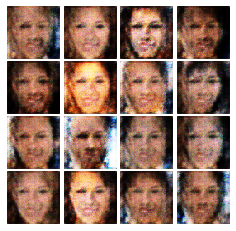


Iter: 4500, D loss: 0.6612, G loss:0.03978


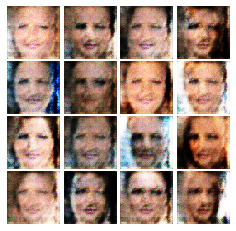


Iter: 4750, D loss: 0.147, G loss:0.8034


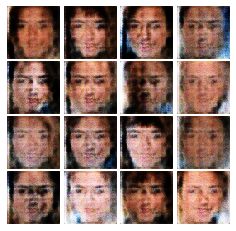


Saving the model as a checkpoint...
EPOCH:  6
Iter: 5000, D loss: 0.3755, G loss:0.5412


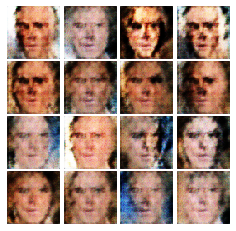


Iter: 5250, D loss: 0.09184, G loss:1.242


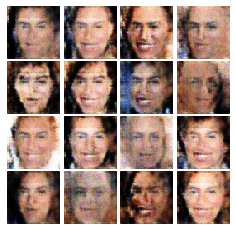


Iter: 5500, D loss: 0.1133, G loss:1.416


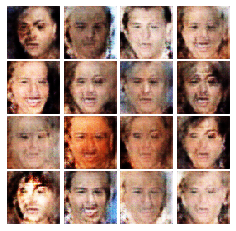


Iter: 5750, D loss: 0.1446, G loss:1.083


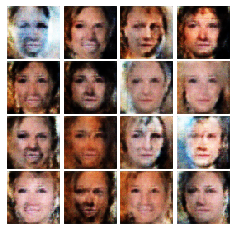


Saving the model as a checkpoint...
EPOCH:  7
Iter: 6000, D loss: 0.943, G loss:0.06616


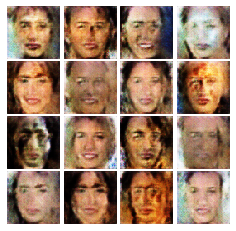


Iter: 6250, D loss: 0.08087, G loss:0.4988


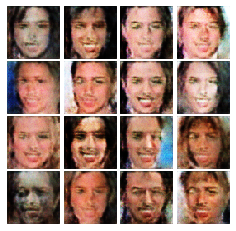


Iter: 6500, D loss: 0.1016, G loss:0.9375


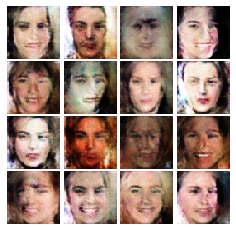


Iter: 6750, D loss: 0.1185, G loss:0.6731


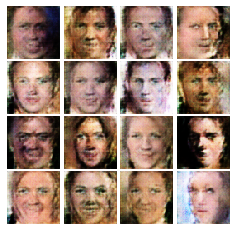


Saving the model as a checkpoint...
EPOCH:  8
Iter: 7000, D loss: 0.12, G loss:0.4015


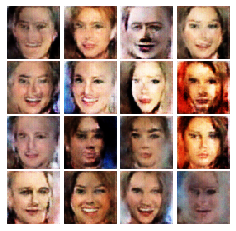


Iter: 7250, D loss: 0.2386, G loss:0.6325


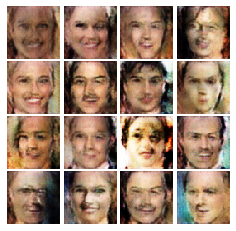


Iter: 7500, D loss: 0.282, G loss:0.1653


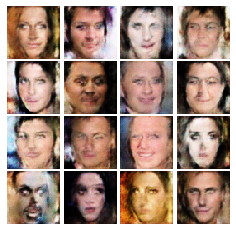


Iter: 7750, D loss: 0.09442, G loss:0.9025


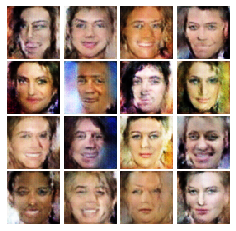


Saving the model as a checkpoint...
EPOCH:  9
Iter: 8000, D loss: 0.09075, G loss:0.5153


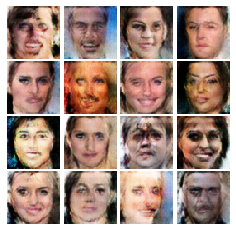


Iter: 8250, D loss: 0.1957, G loss:1.989


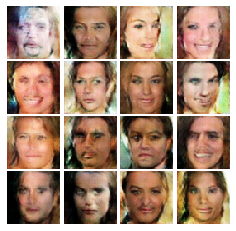


Iter: 8500, D loss: 0.1189, G loss:0.4056


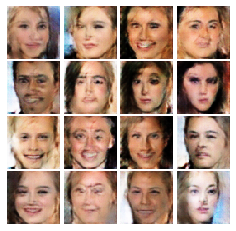


Iter: 8750, D loss: 0.1375, G loss:0.194


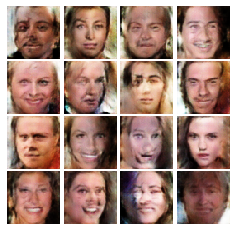


Saving the model as a checkpoint...
EPOCH:  10
Iter: 9000, D loss: 0.1245, G loss:1.165


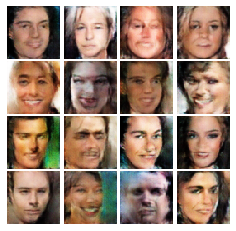


Iter: 9250, D loss: 0.2021, G loss:0.4824


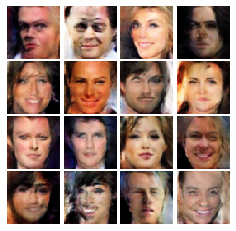


Iter: 9500, D loss: 0.1232, G loss:1.314


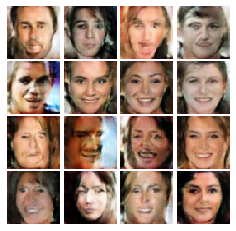


Iter: 9750, D loss: 0.1371, G loss:1.068


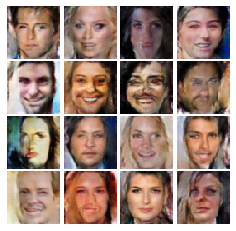


Saving the model as a checkpoint...
EPOCH:  11
Iter: 10000, D loss: 0.5421, G loss:0.06697


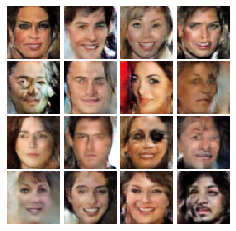


Iter: 10250, D loss: 0.07306, G loss:1.393


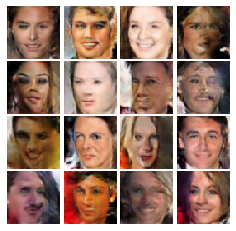


Iter: 10500, D loss: 0.1729, G loss:1.026


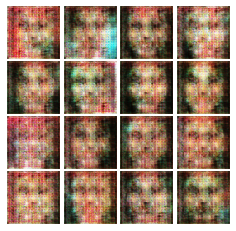


Iter: 10750, D loss: 0.1851, G loss:0.7672


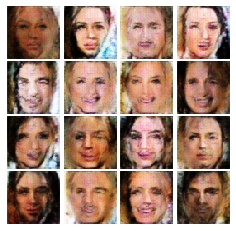


Saving the model as a checkpoint...
EPOCH:  12
Iter: 11000, D loss: 0.2395, G loss:0.3775


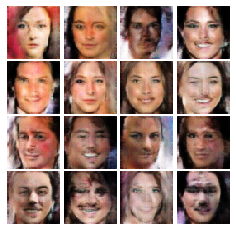


Iter: 11250, D loss: 0.1773, G loss:0.3318


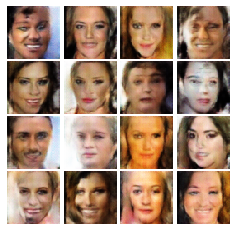


Iter: 11500, D loss: 0.3361, G loss:0.2654


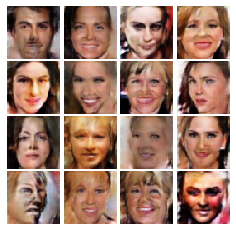


Iter: 11750, D loss: 0.2155, G loss:0.2566


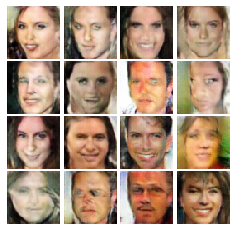


Saving the model as a checkpoint...
EPOCH:  13
Iter: 12000, D loss: 0.1566, G loss:1.236


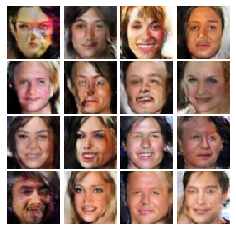


Iter: 12250, D loss: 0.1541, G loss:0.7789


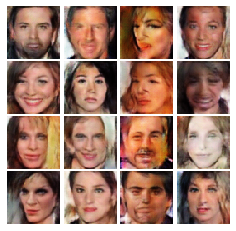


Iter: 12500, D loss: 0.1094, G loss:0.9421


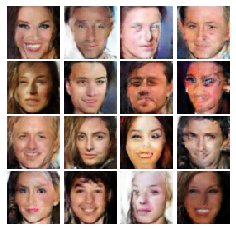


Iter: 12750, D loss: 0.2149, G loss:0.295


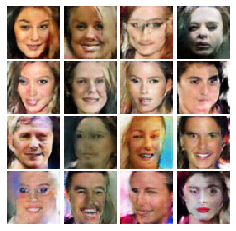


Saving the model as a checkpoint...
EPOCH:  14
Iter: 13000, D loss: 7.577, G loss:4.125


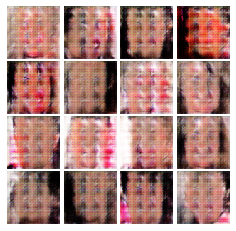


Iter: 13250, D loss: 0.2464, G loss:0.5365


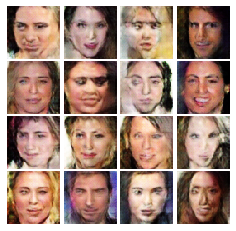


Iter: 13500, D loss: 0.1141, G loss:0.5663


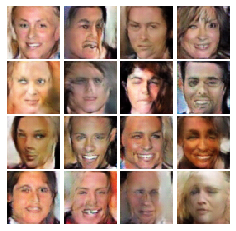


Iter: 13750, D loss: 0.0928, G loss:0.3302


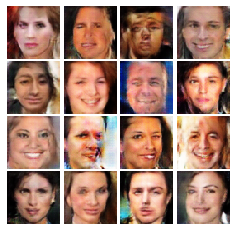


Saving the model as a checkpoint...
EPOCH:  15
Iter: 14000, D loss: 0.1195, G loss:0.3767


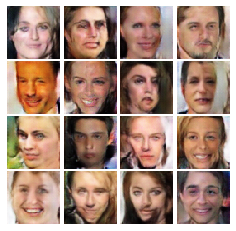


Iter: 14250, D loss: 0.09502, G loss:1.216


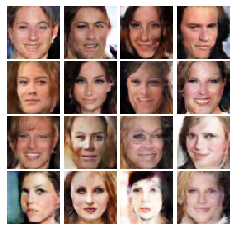


Iter: 14500, D loss: 0.4186, G loss:0.4966


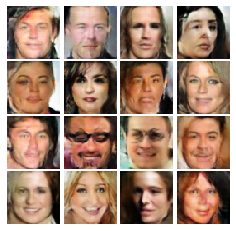


Iter: 14750, D loss: 0.09587, G loss:0.5494


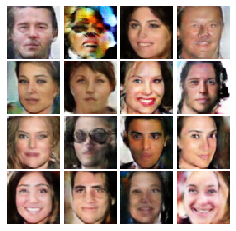


Saving the model as a checkpoint...
EPOCH:  16
Iter: 15000, D loss: 0.3252, G loss:0.2061


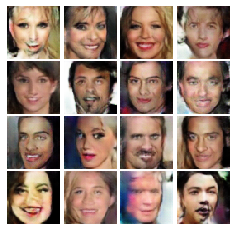


Iter: 15250, D loss: 0.1184, G loss:0.3726


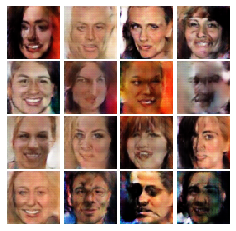


Iter: 15500, D loss: 0.1983, G loss:0.5021


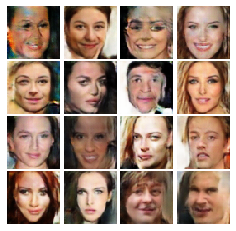


Iter: 15750, D loss: 0.07342, G loss:0.7003


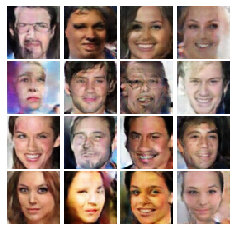


Saving the model as a checkpoint...
EPOCH:  17
Iter: 16000, D loss: 0.04892, G loss:0.4953


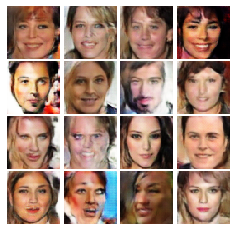


Iter: 16250, D loss: 0.05911, G loss:1.177


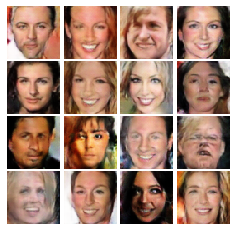


Iter: 16500, D loss: 0.1373, G loss:1.181


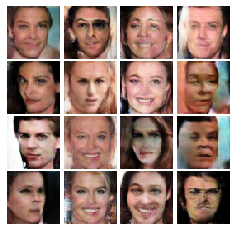


Iter: 16750, D loss: 0.08282, G loss:0.9169


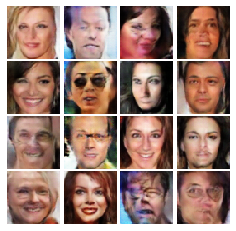


Saving the model as a checkpoint...
EPOCH:  18
Iter: 17000, D loss: 0.1308, G loss:0.9206


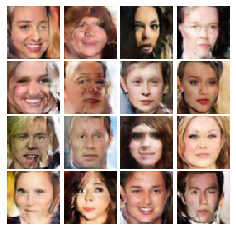


Iter: 17250, D loss: 0.1084, G loss:0.5659


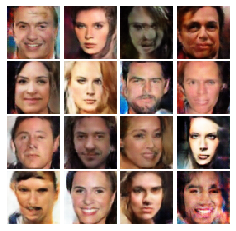


Iter: 17500, D loss: 0.1284, G loss:1.603


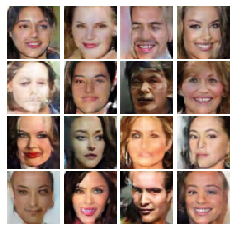


Saving the model as a checkpoint...
EPOCH:  19
Iter: 17750, D loss: 0.1226, G loss:0.5996


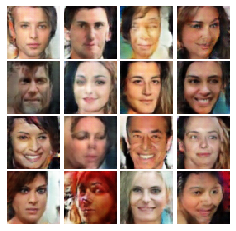


Iter: 18000, D loss: 0.08122, G loss:0.7043


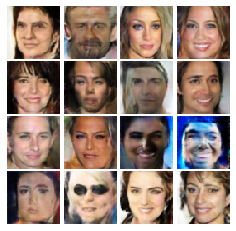


Iter: 18250, D loss: 0.0961, G loss:0.9294


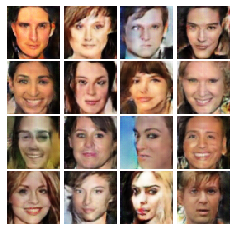


Iter: 18500, D loss: 0.114, G loss:0.5529


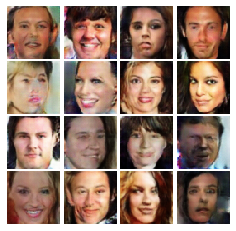


Saving the model as a checkpoint...
EPOCH:  20
Iter: 18750, D loss: 0.04314, G loss:1.175


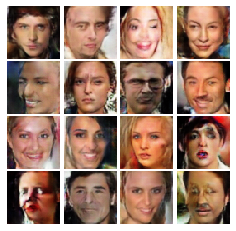


Iter: 19000, D loss: 1.266, G loss:12.43


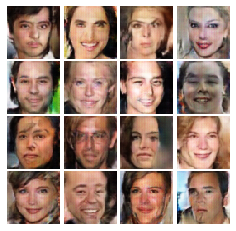


Iter: 19250, D loss: 0.2067, G loss:0.3582


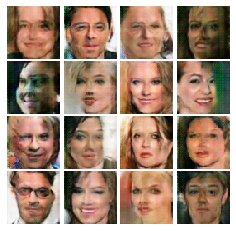


Iter: 19500, D loss: 0.2474, G loss:0.3714


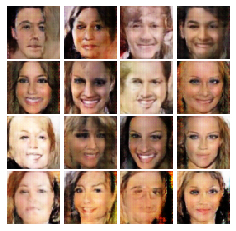


Saving the model as a checkpoint...
EPOCH:  21
Iter: 19750, D loss: 0.2654, G loss:0.3812


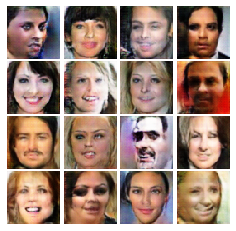


Iter: 20000, D loss: 0.2106, G loss:0.5595


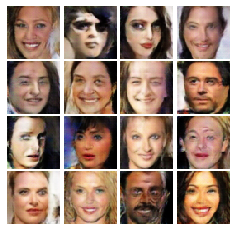


Iter: 20250, D loss: 0.1491, G loss:0.7447


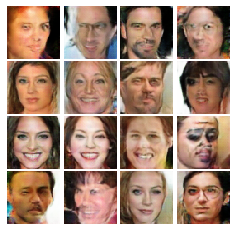


Iter: 20500, D loss: 0.2517, G loss:0.2062


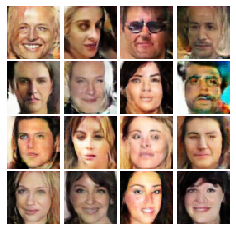


Saving the model as a checkpoint...
EPOCH:  22
Iter: 20750, D loss: 0.1579, G loss:0.8674


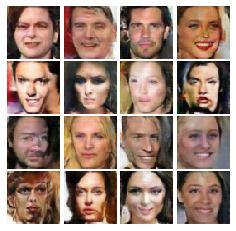


Iter: 21000, D loss: 0.1502, G loss:0.4864


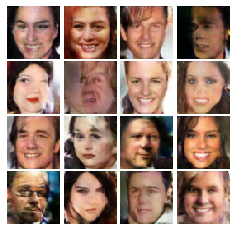


Iter: 21250, D loss: 0.1093, G loss:0.5286


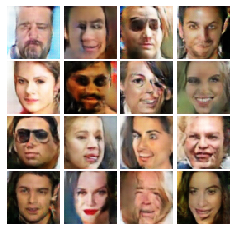


Iter: 21500, D loss: 0.09082, G loss:0.1981


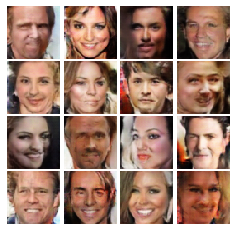


Saving the model as a checkpoint...
EPOCH:  23
Iter: 21750, D loss: 0.0544, G loss:1.111


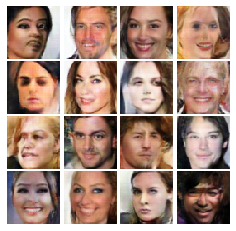


Iter: 22000, D loss: 0.1867, G loss:0.3617


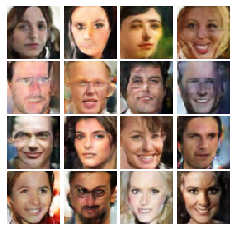


Iter: 22250, D loss: 0.1792, G loss:1.582


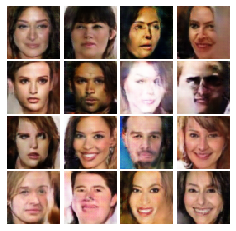


Iter: 22500, D loss: 0.1604, G loss:1.412


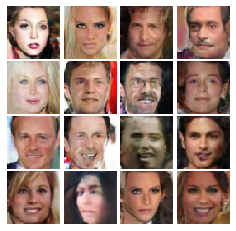


Saving the model as a checkpoint...
EPOCH:  24
Iter: 22750, D loss: 0.06864, G loss:1.182


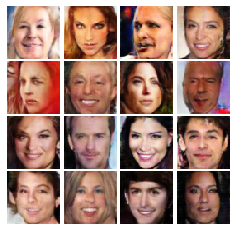


Iter: 23000, D loss: 0.08259, G loss:0.7366


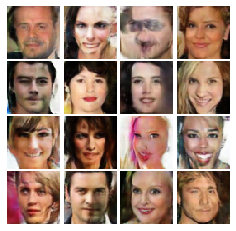


Iter: 23250, D loss: 0.0811, G loss:0.9033


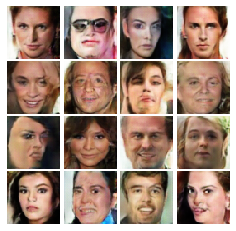


Iter: 23500, D loss: 0.0573, G loss:0.7143


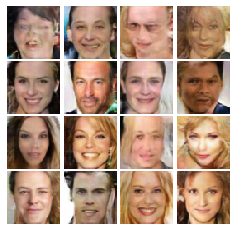


Saving the model as a checkpoint...
EPOCH:  25
Iter: 23750, D loss: 0.1209, G loss:0.6463


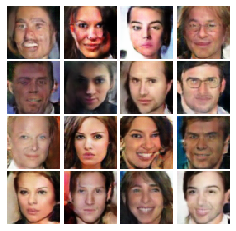


Iter: 24000, D loss: 0.09683, G loss:0.4585


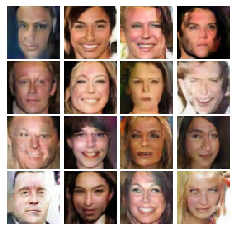


Iter: 24250, D loss: 0.05076, G loss:0.4249


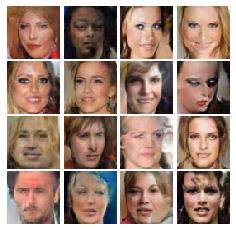


Iter: 24500, D loss: 0.1355, G loss:0.8041


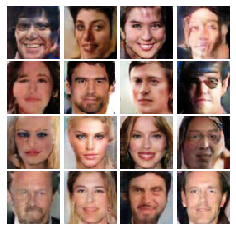


Saving the model as a checkpoint...
EPOCH:  26
Iter: 24750, D loss: 0.05853, G loss:0.8529


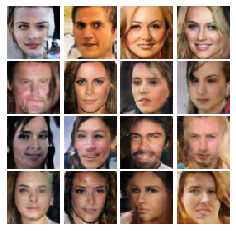


Iter: 25000, D loss: 0.07027, G loss:0.5105


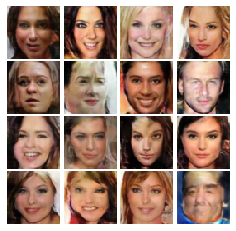


Iter: 25250, D loss: 0.03289, G loss:0.8937


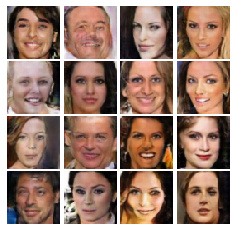


Iter: 25500, D loss: 0.05845, G loss:0.7232


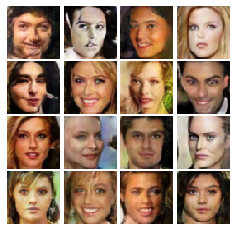


Saving the model as a checkpoint...
EPOCH:  27
Iter: 25750, D loss: 0.06586, G loss:1.175


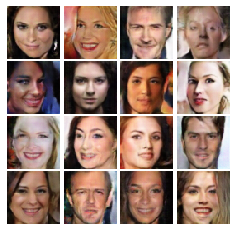


Iter: 26000, D loss: 0.07178, G loss:0.9136


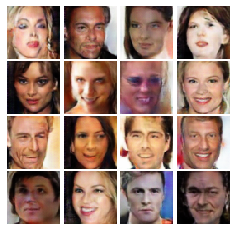


Iter: 26250, D loss: 0.06144, G loss:1.221


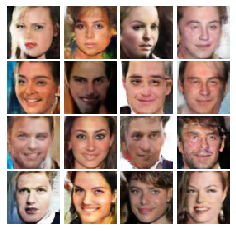


Iter: 26500, D loss: 0.2253, G loss:2.356


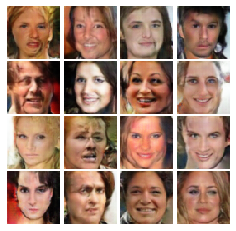


Saving the model as a checkpoint...
EPOCH:  28
Iter: 26750, D loss: 0.09685, G loss:0.4935


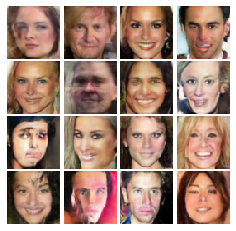


Iter: 27000, D loss: 0.06318, G loss:0.7753


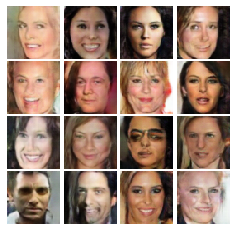


Iter: 27250, D loss: 0.0832, G loss:0.4562


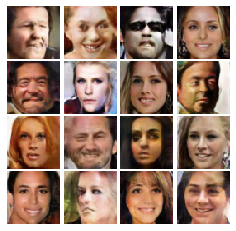


Iter: 27500, D loss: 0.1631, G loss:0.3753


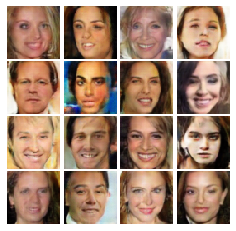


Saving the model as a checkpoint...
EPOCH:  29
Iter: 27750, D loss: 0.04032, G loss:1.189


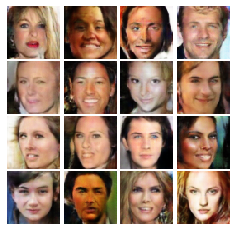


Iter: 28000, D loss: 0.2171, G loss:0.4622


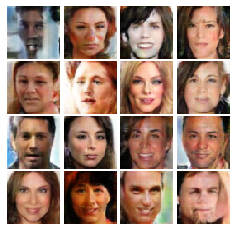


Iter: 28250, D loss: 0.1125, G loss:0.5711


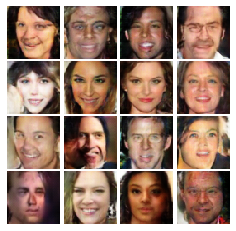


Iter: 28500, D loss: 0.07715, G loss:0.6134


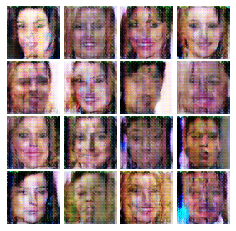


Saving the model as a checkpoint...
EPOCH:  30
Iter: 28750, D loss: 0.07439, G loss:0.6452


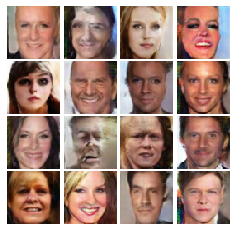


Iter: 29000, D loss: 0.0452, G loss:0.4731


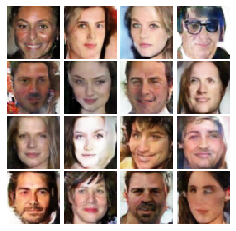


Iter: 29250, D loss: 0.0332, G loss:0.6952


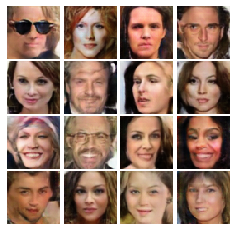


Iter: 29500, D loss: 0.0339, G loss:0.8393


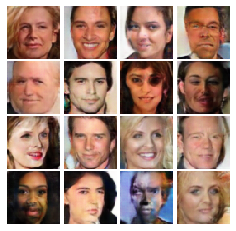


Saving the model as a checkpoint...


In [ ]:
# LSGANf

# call Discriminator and Generator 
ls_dc_D = dc_discriminator().type(torch.float64).to(device)
ls_dc_G = dc_generator().type(torch.float64).to(device)


print("learning_rate:", learning_rate)
# call optimizers for both discriminator and generator for training. (Use Adam with lr=1e-3, betas = (0.5, 0.999))
ls_dc_D_solver = torch.optim.Adam(ls_dc_D.parameters(), lr=learning_rate, betas=(0.5, 0.999))
ls_dc_G_solver = torch.optim.Adam(ls_dc_G.parameters(), lr=learning_rate, betas=(0.5, 0.999))

# call train function to train
dc_train(ls_dc_D, ls_dc_G, ls_dc_D_solver, ls_dc_G_solver, ls_discriminator_loss, ls_generator_loss, train_loader=celeba_loader_train, device=device, ckpt_dir = path_to_homework + '/ckpts/LS_DC_gan_CelebA/')

